In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk(r'D:\Real Estate\_PLP-ML-AI\House_data\dataset'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

ModuleNotFoundError: No module named 'numpy'

In [2]:
# !pip install python_splitter

In [3]:
import python_splitter
# If you want to create only Train-Test Folder(not Validation Folder)
python_splitter.split_from_folder("D:\Real Estate\_PLP-ML-AI\House_data\dataset", train = 0.7, test = 0.3)

✅Checking SOURCE directory...
0.7 0 0.3
✅Checking percentage validation...
✅Making required directories...


<>:3: SyntaxWarning: invalid escape sequence '\R'
<>:3: SyntaxWarning: invalid escape sequence '\R'
C:\Users\Archiculture01\AppData\Local\Temp\ipykernel_22800\3641565826.py:3: SyntaxWarning: invalid escape sequence '\R'
  python_splitter.split_from_folder("D:\Real Estate\_PLP-ML-AI\House_data\dataset", train = 0.7, test = 0.3)


✅Shuffling data...
✅Getting ready for copying files...

-------------Successfully splitted !!!--------------- 


In [4]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
from tensorflow.keras.applications import MobileNet
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

## Splitted Data

In [5]:
target_img_shape = (224,224)
train_dir = r'D:\Real Estate\_PLP-ML-AI\House_data\Train_Test_Folder\train'
val_dir = r'D:\Real Estate\_PLP-ML-AI\House_data\Train_Test_Folder\test'

In [6]:
train_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)
train_set = train_datagen.flow_from_directory(train_dir, target_size = target_img_shape, batch_size = 32, class_mode = 'sparse')

# Augmenting training data with transformations
# train_datagen = ImageDataGenerator(
#     preprocessing_function=preprocess_input,
#     rotation_range=0,      # Randomly rotate images by 20 degrees
#     width_shift_range=0.2,  # Randomly shift images horizontally (15% of the width)
#     height_shift_range=0.2, # Randomly shift images vertically (15% of the height)
#     shear_range=0.9,       # Randomly apply shearing
#     zoom_range=0.2,        # Randomly zoom inside pictures
#     horizontal_flip=True,   # Randomly flip images horizontally
#     fill_mode='nearest'     # Fill pixels when the image is rotated or shifted
# )

# train_set = train_datagen.flow_from_directory(
#     train_dir, 
#     target_size=target_img_shape, 
#     batch_size=32, 
#     class_mode='sparse'
# )

val_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)
val_set = val_datagen.flow_from_directory(val_dir, target_size = target_img_shape, batch_size = 32, class_mode = 'sparse')

Found 267 images belonging to 13 classes.
Found 120 images belonging to 13 classes.


{'ML-AR-COLONIAL': 0, 'ML-AR-Chicago School': 1, 'ML-AR-Classic': 2, 'ML-AR-MEDITERRANEAN': 3, 'ML-AR-MID CENTURY': 4, 'ML-AR-Modern': 5, 'ML-AR-Modern Minimal': 6, 'ML-AR-Oriental': 7, 'ML-AR-SCANDINAVIAN': 8, 'ML-AR-THAI': 9, 'ML-AR-TRANSITIONAL': 10, 'ML-AR-TUDOR HOUSE': 11, 'ML-AR-VICTORIAN': 12}
(32, 224, 224, 3)
(32,)
class 0.0


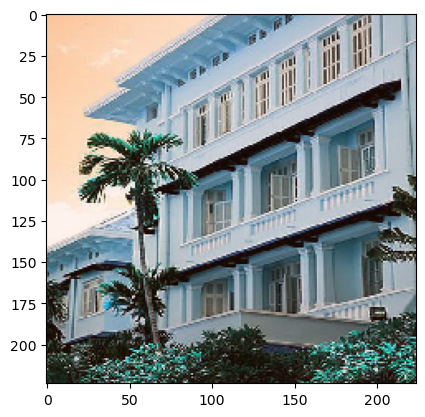

In [7]:
print(train_set.class_indices)
for image_batch, labels_batch in train_set:
    print(image_batch.shape)
    print(labels_batch.shape)

    img = image_batch[0] - image_batch[0].min()
    img /= 275.0
    plt.imshow(img)
    print('class', labels_batch[0])
    break

In [8]:
ids, counts = np.unique(train_set.classes, return_counts = True)
print(ids)
print(counts)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]
[20 20 20 20 26 11 20 20 20 18 20 32 20]


In [9]:
labels = (train_set.class_indices)
labels = dict((v,k) for k,v in labels.items())
labels

for i in ids:
    print('{:>8} = {}'.format(labels[i], counts[i]))

ML-AR-COLONIAL = 20
ML-AR-Chicago School = 20
ML-AR-Classic = 20
ML-AR-MEDITERRANEAN = 20
ML-AR-MID CENTURY = 26
ML-AR-Modern = 11
ML-AR-Modern Minimal = 20
ML-AR-Oriental = 20
ML-AR-SCANDINAVIAN = 20
ML-AR-THAI = 18
ML-AR-TRANSITIONAL = 20
ML-AR-TUDOR HOUSE = 32
ML-AR-VICTORIAN = 20


In [10]:
ids, counts = np.unique(val_set.classes, return_counts = True)
print(ids)
print(counts)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]
[ 9  9  9  9 12  5  9  9  9  8  9 14  9]


In [11]:
_, train_count = np.unique(train_set.classes, return_counts = True)
_, val_count = np.unique(val_set.classes, return_counts = True)

print('Ratio Validation/Training set:', val_count/train_count * 100)

Ratio Validation/Training set: [45.         45.         45.         45.         46.15384615 45.45454545
 45.         45.         45.         44.44444444 45.         43.75
 45.        ]


In [12]:
in_shape = (target_img_shape[0], target_img_shape[1], 3)
in_shape

(224, 224, 3)

In [13]:
# from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D
base_model = ResNet50(include_top=False,
                      weights='imagenet',
                      input_shape=in_shape)

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())  # Replacing Flatten with GAP to reduce overfitting
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.4))  # Dropout to reduce overfitting
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(13, activation='softmax'))  # Output layer for 13 classes
base_model.trainable = False
# base_model.trainable = True
model.summary()


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 7, 7, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 13)             │           845 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,859,085 (91.02 MB)

 Trainable params: 271,373 (1.04 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [14]:
# from tensorflow.keras.applications import ResNet50
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
# from tensorflow.keras.optimizers import Adam

# # Load the ResNet50 model pre-trained on ImageNet
# base_model = ResNet50(include_top=False, weights='imagenet', input_shape=in_shape)

# # Adding the classification head
# x = base_model.output
# x = GlobalAveragePooling2D()(x)  # Global average pooling layer
# output_layer = Dense(13, activation='softmax')(x)  # Output layer for 13 classes

# # Creating the final model
# model = Model(inputs=base_model.input, outputs=output_layer)

# # Optionally, you can freeze the base model layers during initial training
# base_model.trainable = False

# # Compile the model
# # model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

# model.summary()

In [15]:
# base_model.trainable = False

In [16]:
print("Trainable..\n---")
for variable in model.trainable_variables:
    print(variable.name)

Trainable..
---
kernel
bias
kernel
bias
kernel
bias


In [17]:
# resnet.summary()

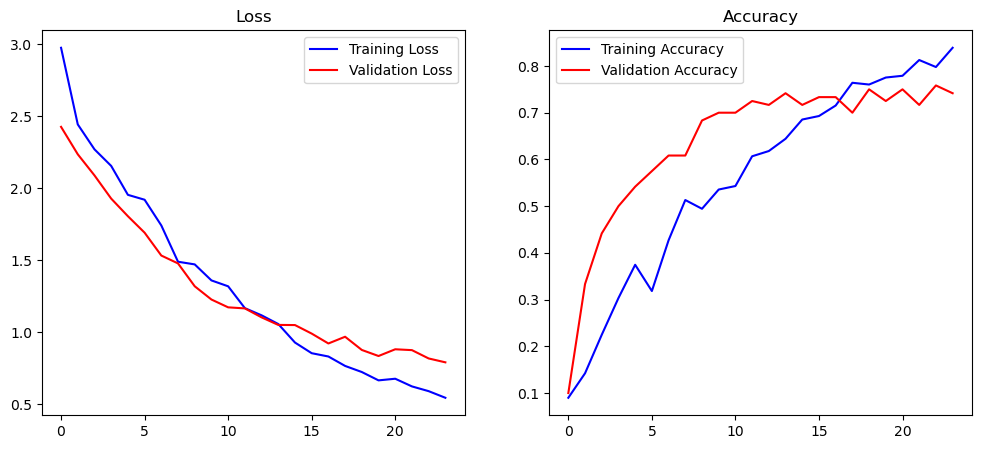

9/9 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.8317 - loss: 0.5812 - val_accuracy: 0.7417 - val_loss: 0.7901
Epoch 25/100
4/9 ━━━━━━━━━━━━━━━━━━━━ 4s 983ms/step - accuracy: 0.8480 - loss: 0.5069

UnknownError: Graph execution error:

Detected at node PyFunc defined at (most recent call last):
<stack traces unavailable>
FileNotFoundError: [Errno 2] No such file or directory: 'D:\\Real Estate\\_PLP-ML-AI\\House_data\\Train_Test_Folder\\train\\ML-AR-Classic\\0239a424aeaf329a4a2d2def5b3494b2.jpg'
Traceback (most recent call last):

  File "c:\Users\Archiculture01\anaconda3\Lib\site-packages\tensorflow\python\ops\script_ops.py", line 269, in __call__
    ret = func(*args)
          ^^^^^^^^^^^

  File "c:\Users\Archiculture01\anaconda3\Lib\site-packages\tensorflow\python\autograph\impl\api.py", line 643, in wrapper
    return func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^

  File "c:\Users\Archiculture01\anaconda3\Lib\site-packages\tensorflow\python\data\ops\from_generator_op.py", line 198, in generator_py_func
    values = next(generator_state.get_iterator(iterator_id))
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^

  File "c:\Users\Archiculture01\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py", line 247, in _finite_generator
    yield self.py_dataset[i]
          ~~~~~~~~~~~~~~~^^^

  File "c:\Users\Archiculture01\anaconda3\Lib\site-packages\keras\src\legacy\preprocessing\image.py", line 68, in __getitem__
    return self._get_batches_of_transformed_samples(index_array)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^

  File "c:\Users\Archiculture01\anaconda3\Lib\site-packages\keras\src\legacy\preprocessing\image.py", line 313, in _get_batches_of_transformed_samples
    img = image_utils.load_img(
          ^^^^^^^^^^^^^^^^^^^^^

  File "c:\Users\Archiculture01\anaconda3\Lib\site-packages\keras\src\utils\image_utils.py", line 235, in load_img
    with open(path, "rb") as f:
         ^^^^^^^^^^^^^^^^

FileNotFoundError: [Errno 2] No such file or directory: 'D:\\Real Estate\\_PLP-ML-AI\\House_data\\Train_Test_Folder\\train\\ML-AR-Classic\\0239a424aeaf329a4a2d2def5b3494b2.jpg'


	 [[{{node PyFunc}}]]
	 [[IteratorGetNext]] [Op:__inference_one_step_on_iterator_12028]

In [18]:
import time
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
from IPython.display import clear_output, display

# Model Compilation
model.compile(optimizer=Adam(learning_rate=0.001), 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
es = EarlyStopping(monitor='val_loss', verbose=1, patience=5, restore_best_weights=True)
mc = ModelCheckpoint('best_model13cls.keras', monitor='val_accuracy', verbose=1, save_best_only=True)

# Custom Callback for Real-Time Plotting with IPython.display
class RealTimePlot(Callback):
    def on_train_begin(self, logs=None):
        self.epochs = []
        self.losses = []
        self.val_losses = []
        self.accuracies = []
        self.val_accuracies = []

    def on_epoch_end(self, epoch, logs=None):
        self.epochs.append(epoch)
        self.losses.append(logs['loss'])
        self.val_losses.append(logs['val_loss'])
        self.accuracies.append(logs['accuracy'])
        self.val_accuracies.append(logs['val_accuracy'])

        # Clear the output and plot the updated data
        clear_output(wait=True)
        plt.figure(figsize=(12, 5))

        # Plotting the losses
        plt.subplot(1, 2, 1)
        plt.plot(self.epochs, self.losses, label='Training Loss', color='b')
        plt.plot(self.epochs, self.val_losses, label='Validation Loss', color='r')
        plt.title("Loss")
        plt.legend()

        # Plotting the accuracies
        plt.subplot(1, 2, 2)
        plt.plot(self.epochs, self.accuracies, label='Training Accuracy', color='b')
        plt.plot(self.epochs, self.val_accuracies, label='Validation Accuracy', color='r')
        plt.title("Accuracy")
        plt.legend()

        plt.show()

# Instantiate the custom callback
real_time_plot = RealTimePlot()

# Training the model with the custom callback
start = time.time()
history = model.fit(train_set,
                    validation_data=val_set,
                    epochs=100, 
                    verbose=1, 
                    callbacks=[es, mc, real_time_plot])
end = time.time()

print("Time Taken: {:.2f} minutes".format((end - start)/60))


In [ ]:
acc = model.evaluate(val_set, steps=len(val_set), verbose=1)
print('score = {:.3f}'.format(acc[1]))

4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step - accuracy: 0.6940 - loss: 0.8593
score = 0.675


In [ ]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
def predict(img_fname):
    # Load and preprocess the image
    img = load_img(img_fname, target_size=target_img_shape)  # Adjust target_img_shape as per your model's input
    plt.figure()  # Open a new figure for each image
    plt.imshow(img)
    plt.axis('off')  # Turn off axes for better viewing
    plt.title(os.path.basename(os.path.dirname(img_fname)))
    plt.show()

    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    
    # Make prediction
    pred = model.predict(img)
    pred_probabilities = pred[0]

    # Get the top 3 predictions
    top_indices = pred_probabilities.argsort()[-3:][::-1]  # Indices of top 3 predictions
    top_labels = [(list(labels.values())[i], pred_probabilities[i]) for i in top_indices]  # Assuming `labels` is a dictionary or list

    # Display the top 3 predictions with their probabilities
    print("Top 3 Predictions:")
    for label, probability in top_labels:
        print(f"{label} : {round(probability * 100, 2):.2f}%")

    # Extracting the actual class from the file path
    actual_cls = os.path.basename(os.path.dirname(img_fname))  # Assumes the image file is within a folder named by its class
    print('Actual Class:', actual_cls)
    
    # Get the predicted class (highest probability)
    pred_cls = list(labels.values())[np.argmax(pred, -1)[0]]
    print('Prediction:', pred_cls)


In [ ]:
labels

{0: 'ML-AR-COLONIAL',
 1: 'ML-AR-Chicago School',
 2: 'ML-AR-Classic',
 3: 'ML-AR-MEDITERRANEAN',
 4: 'ML-AR-MID CENTURY',
 5: 'ML-AR-Modern',
 6: 'ML-AR-Modern Minimal',
 7: 'ML-AR-Oriental',
 8: 'ML-AR-SCANDINAVIAN',
 9: 'ML-AR-THAI',
 10: 'ML-AR-TRANSITIONAL',
 11: 'ML-AR-TUDOR HOUSE',
 12: 'ML-AR-VICTORIAN'}

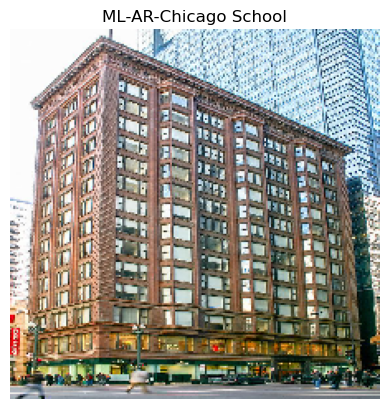

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-COLONIAL : 0.00%
ML-AR-Classic : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


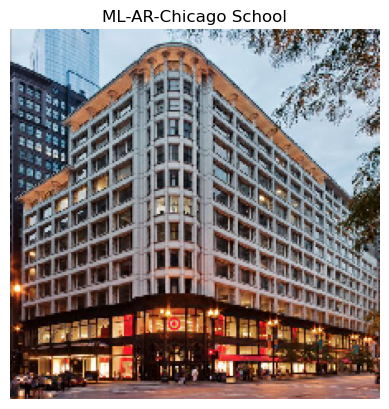

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-MEDITERRANEAN : 0.00%
ML-AR-Classic : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


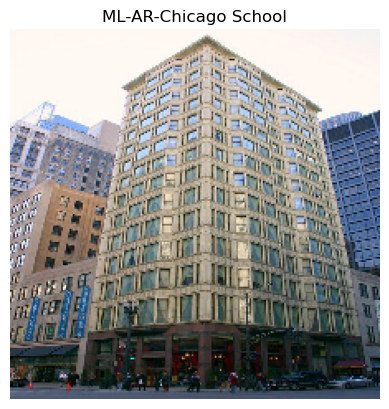

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-TRANSITIONAL : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


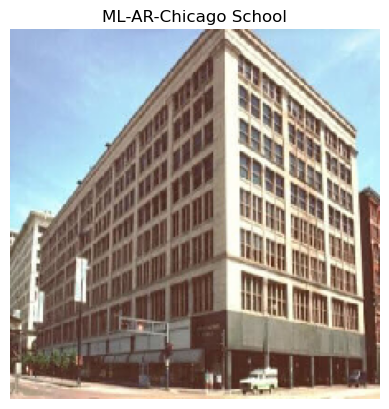

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-MID CENTURY : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


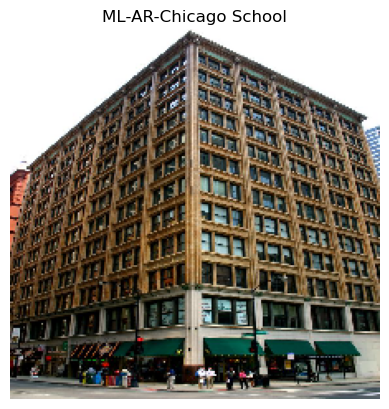

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-MEDITERRANEAN : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


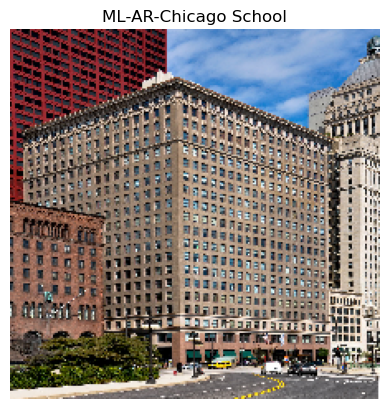

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.98%
ML-AR-MEDITERRANEAN : 0.01%
ML-AR-COLONIAL : 0.01%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


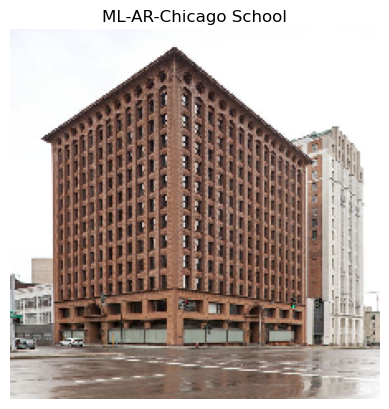

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.98%
ML-AR-Classic : 0.00%
ML-AR-COLONIAL : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


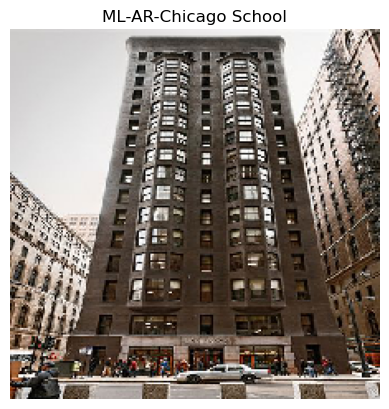

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-COLONIAL : 0.00%
ML-AR-MEDITERRANEAN : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


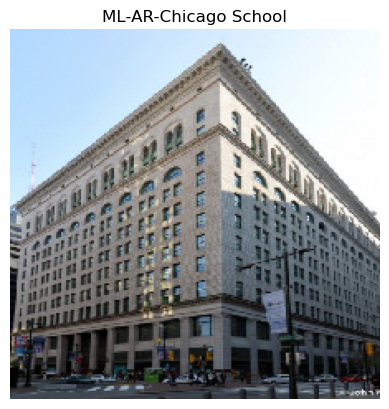

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.94%
ML-AR-TRANSITIONAL : 0.01%
ML-AR-MEDITERRANEAN : 0.01%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


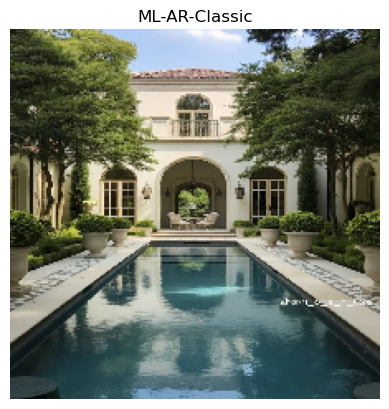

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-Classic : 95.58%
ML-AR-MEDITERRANEAN : 3.60%
ML-AR-Oriental : 0.67%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


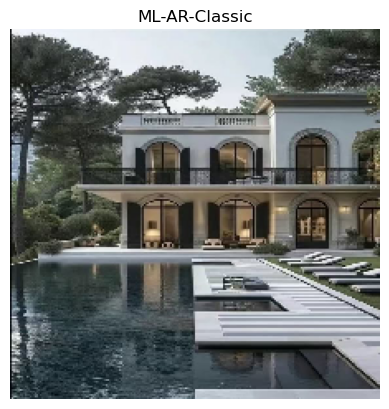

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 44.97%
ML-AR-Oriental : 23.67%
ML-AR-Classic : 15.53%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Modern Minimal


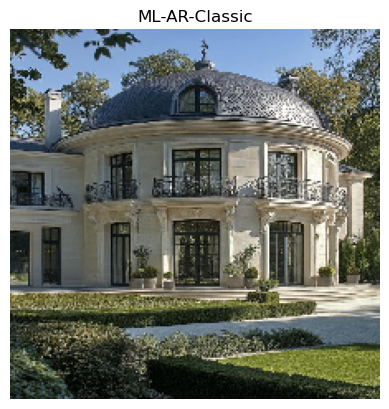

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 51.76%
ML-AR-Classic : 29.36%
ML-AR-TRANSITIONAL : 7.79%
Actual Class: ML-AR-Classic
Prediction: ML-AR-VICTORIAN


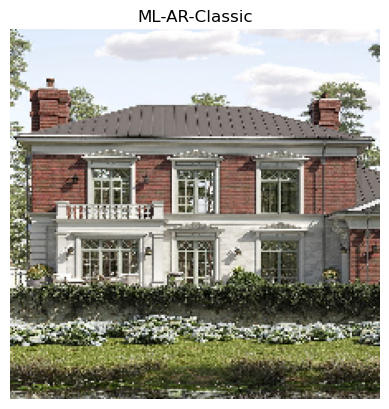

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Top 3 Predictions:
ML-AR-Classic : 67.83%
ML-AR-TRANSITIONAL : 5.54%
ML-AR-Oriental : 5.44%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


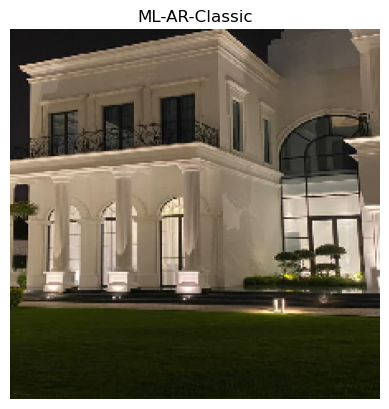

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 39.27%
ML-AR-Modern Minimal : 19.74%
ML-AR-Classic : 19.50%
Actual Class: ML-AR-Classic
Prediction: ML-AR-COLONIAL


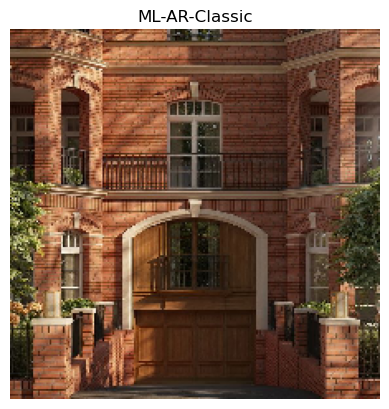

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 51.23%
ML-AR-Classic : 30.47%
ML-AR-Oriental : 10.30%
Actual Class: ML-AR-Classic
Prediction: ML-AR-COLONIAL


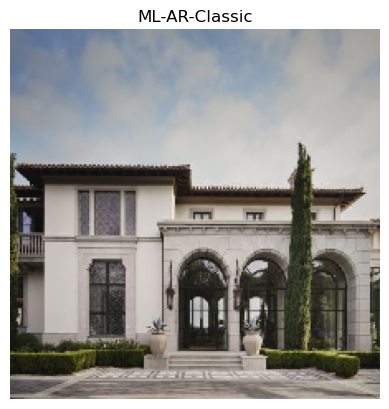

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 55.67%
ML-AR-Classic : 35.34%
ML-AR-Oriental : 4.33%
Actual Class: ML-AR-Classic
Prediction: ML-AR-MEDITERRANEAN


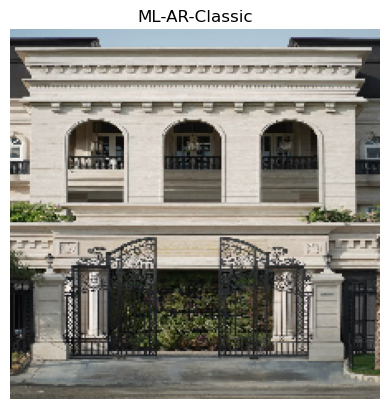

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Top 3 Predictions:
ML-AR-Classic : 51.68%
ML-AR-COLONIAL : 28.03%
ML-AR-Oriental : 12.62%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


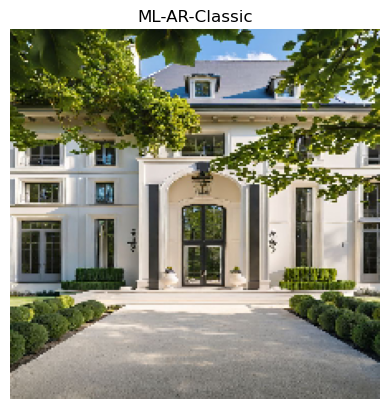

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 33.98%
ML-AR-COLONIAL : 20.57%
ML-AR-Classic : 18.06%
Actual Class: ML-AR-Classic
Prediction: ML-AR-MEDITERRANEAN


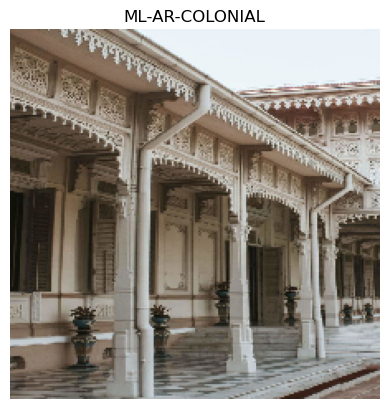

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 83.91%
ML-AR-MEDITERRANEAN : 6.39%
ML-AR-Classic : 2.89%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


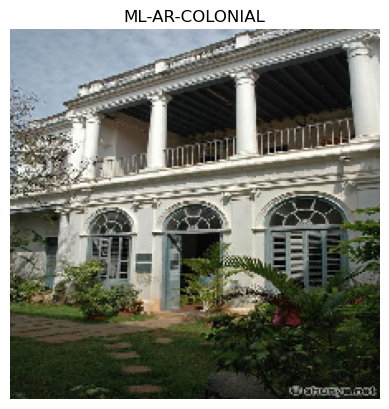

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 56.43%
ML-AR-VICTORIAN : 12.36%
ML-AR-Classic : 7.21%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


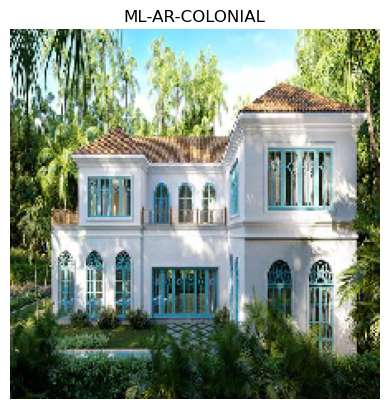

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 55.72%
ML-AR-VICTORIAN : 15.48%
ML-AR-MEDITERRANEAN : 8.69%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


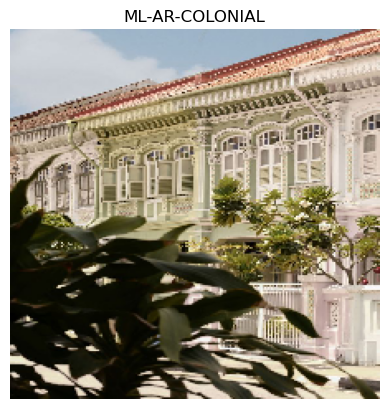

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 68.09%
ML-AR-Classic : 11.52%
ML-AR-Oriental : 6.90%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


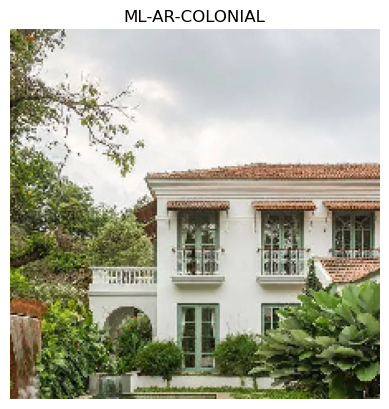

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 48.60%
ML-AR-COLONIAL : 31.20%
ML-AR-Oriental : 10.26%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-MEDITERRANEAN


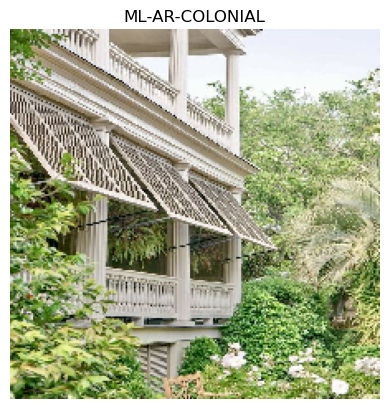

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 33.98%
ML-AR-THAI : 21.14%
ML-AR-VICTORIAN : 14.11%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-TUDOR HOUSE


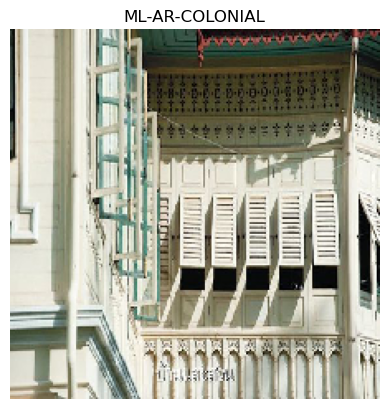

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 98.46%
ML-AR-VICTORIAN : 0.66%
ML-AR-Classic : 0.34%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


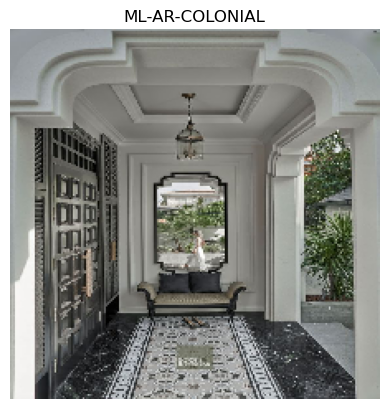

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 57.23%
ML-AR-Classic : 21.77%
ML-AR-COLONIAL : 15.23%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-VICTORIAN


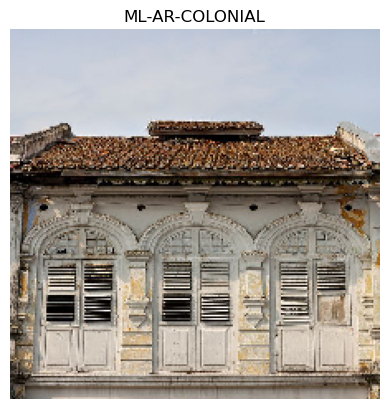

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 70.58%
ML-AR-VICTORIAN : 12.19%
ML-AR-Classic : 10.87%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


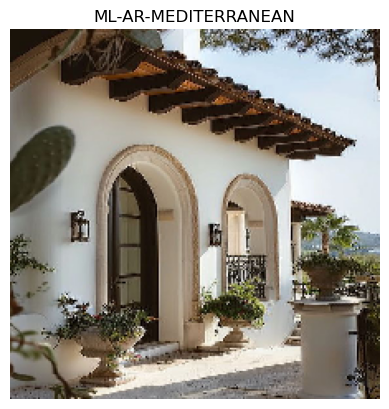

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 97.66%
ML-AR-COLONIAL : 2.18%
ML-AR-Oriental : 0.05%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


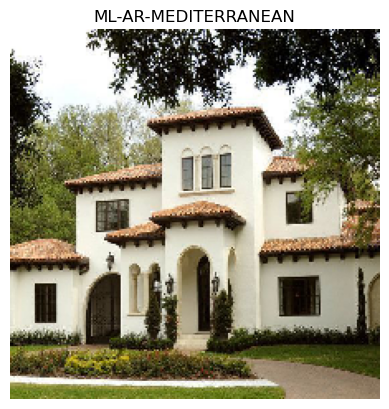

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 99.74%
ML-AR-COLONIAL : 0.19%
ML-AR-TUDOR HOUSE : 0.02%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


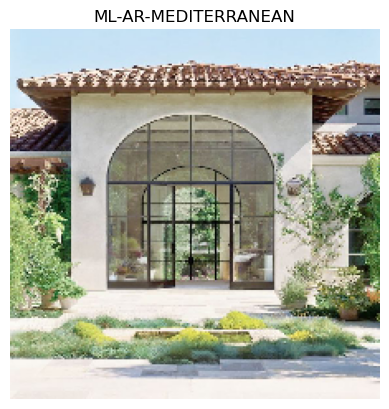

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 54.93%
ML-AR-MEDITERRANEAN : 38.03%
ML-AR-TUDOR HOUSE : 2.35%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-COLONIAL


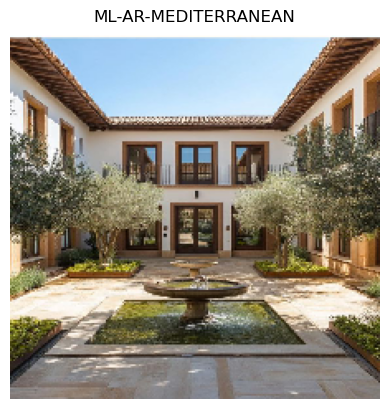

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 82.67%
ML-AR-Classic : 12.07%
ML-AR-Oriental : 4.48%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


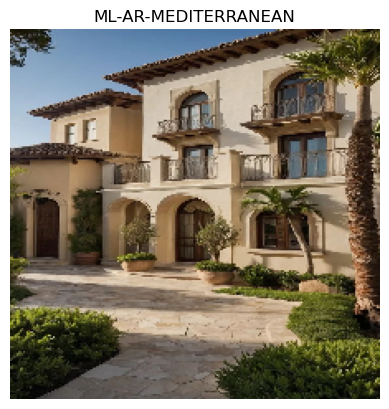

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 98.01%
ML-AR-COLONIAL : 1.51%
ML-AR-Oriental : 0.26%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


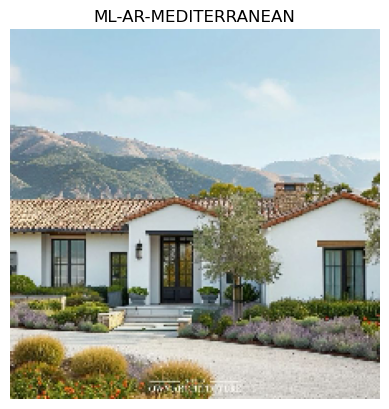

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 99.30%
ML-AR-COLONIAL : 0.42%
ML-AR-Oriental : 0.14%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


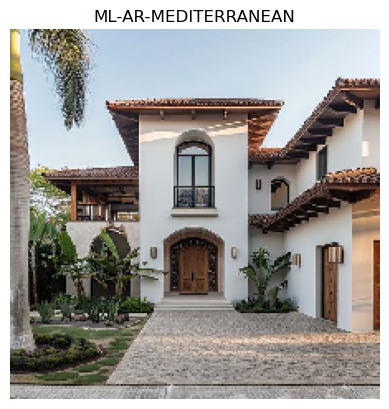

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 95.32%
ML-AR-COLONIAL : 4.29%
ML-AR-TUDOR HOUSE : 0.17%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


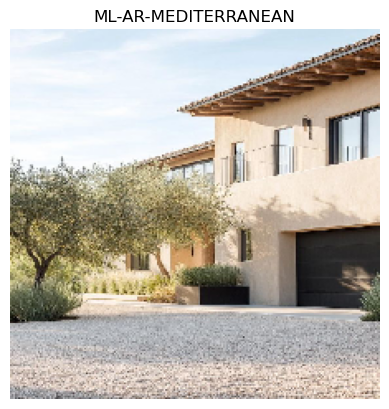

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 91.77%
ML-AR-COLONIAL : 4.38%
ML-AR-Oriental : 1.68%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


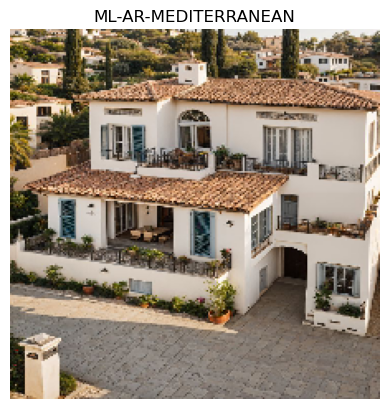

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 93.56%
ML-AR-COLONIAL : 6.40%
ML-AR-Oriental : 0.01%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


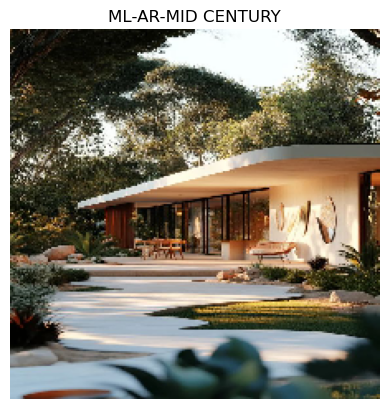

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.28%
ML-AR-Oriental : 0.42%
ML-AR-MEDITERRANEAN : 0.18%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


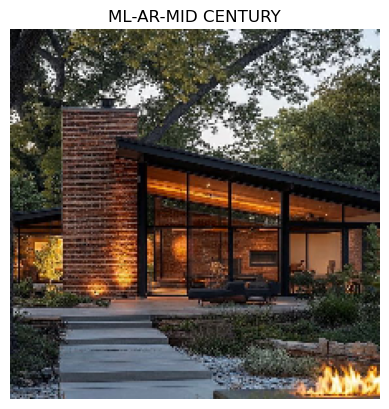

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 74.90%
ML-AR-Oriental : 23.82%
ML-AR-THAI : 0.43%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


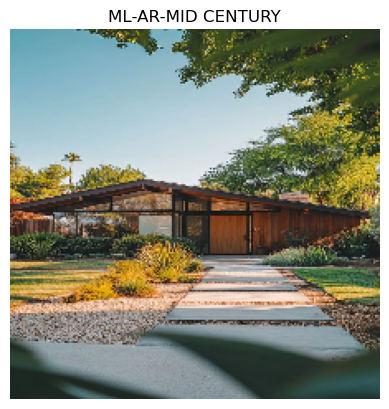

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 100.00%
ML-AR-VICTORIAN : 0.00%
ML-AR-Modern : 0.00%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


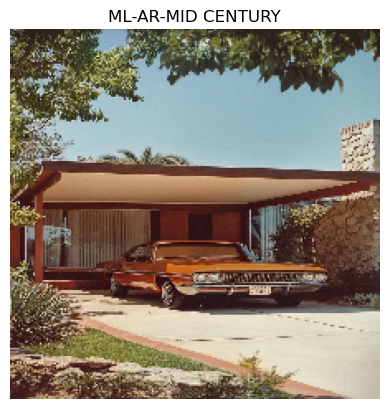

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 92.34%
ML-AR-Modern : 5.31%
ML-AR-Modern Minimal : 1.53%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


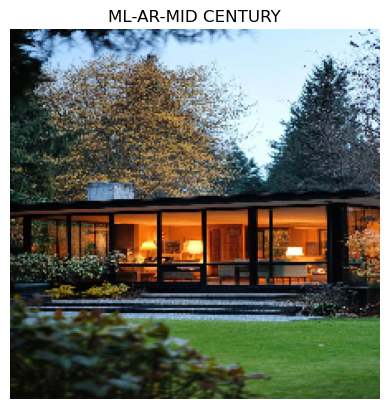

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.73%
ML-AR-Oriental : 0.11%
ML-AR-Modern : 0.07%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


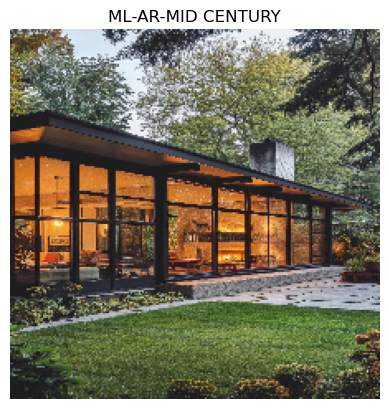

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.88%
ML-AR-Oriental : 0.06%
ML-AR-MEDITERRANEAN : 0.02%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


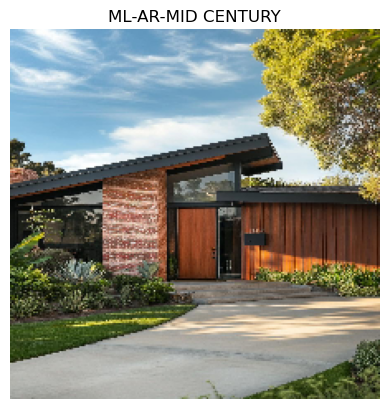

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Top 3 Predictions:
ML-AR-Oriental : 56.12%
ML-AR-MID CENTURY : 43.20%
ML-AR-THAI : 0.34%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-Oriental


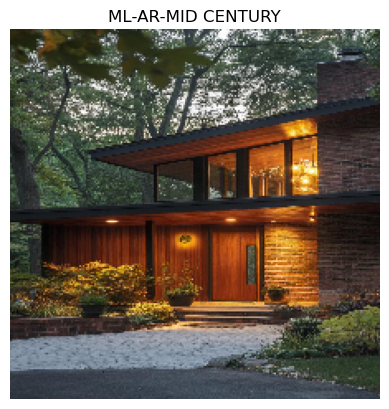

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 98.90%
ML-AR-Oriental : 0.89%
ML-AR-MEDITERRANEAN : 0.07%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


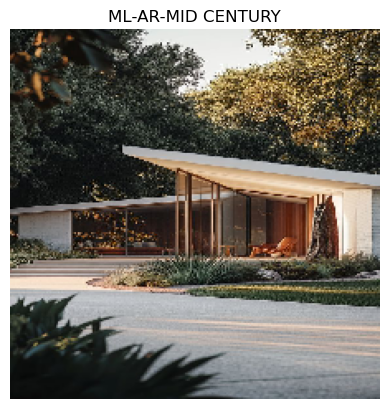

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.99%
ML-AR-Oriental : 0.01%
ML-AR-Modern Minimal : 0.00%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


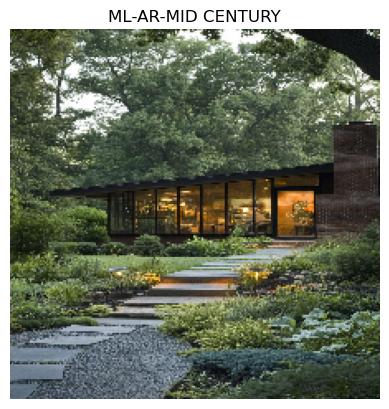

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.91%
ML-AR-Oriental : 0.05%
ML-AR-Modern : 0.02%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


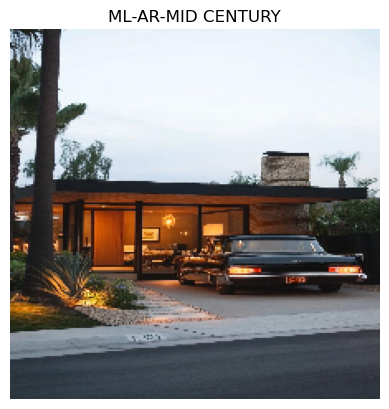

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 81.57%
ML-AR-Modern Minimal : 10.69%
ML-AR-Modern : 6.13%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


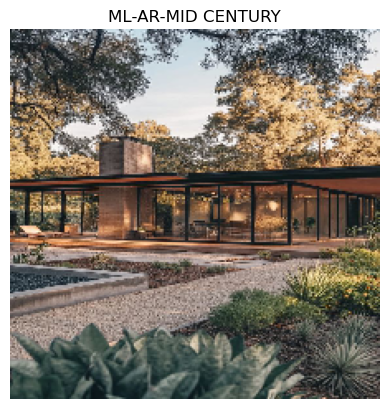

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 88.06%
ML-AR-Oriental : 11.26%
ML-AR-MEDITERRANEAN : 0.27%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


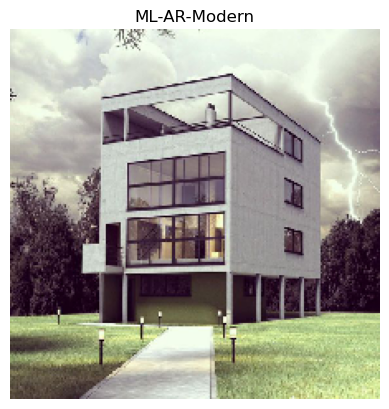

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 90.15%
ML-AR-Modern : 5.81%
ML-AR-SCANDINAVIAN : 1.99%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


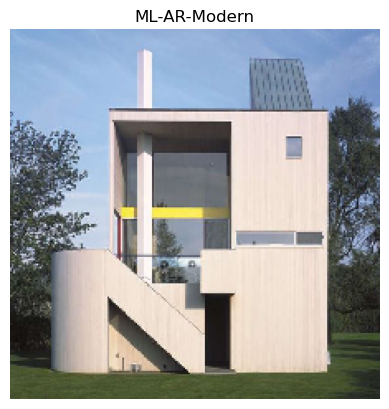

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 99.21%
ML-AR-SCANDINAVIAN : 0.60%
ML-AR-Modern : 0.18%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


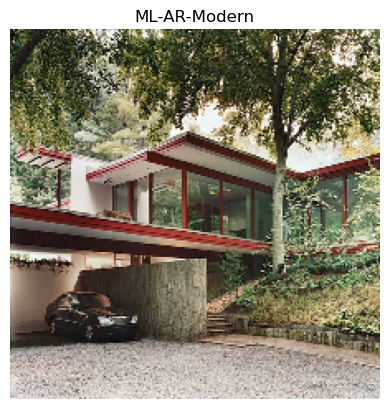

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Top 3 Predictions:
ML-AR-Oriental : 41.38%
ML-AR-MID CENTURY : 25.99%
ML-AR-THAI : 23.91%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Oriental


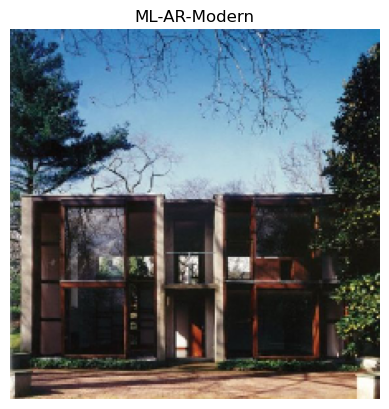

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 85.11%
ML-AR-Modern : 4.09%
ML-AR-MID CENTURY : 3.81%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


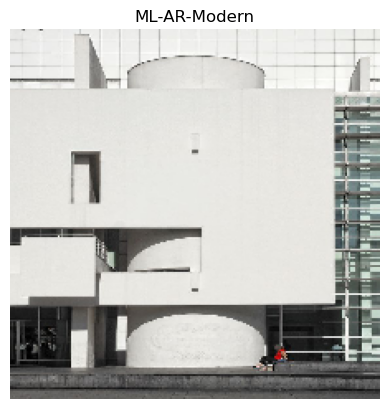

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 73.76%
ML-AR-Modern : 20.68%
ML-AR-SCANDINAVIAN : 4.25%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


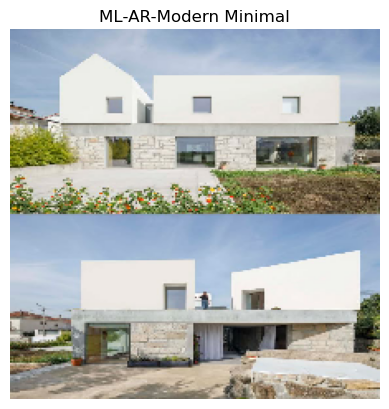

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 88.39%
ML-AR-SCANDINAVIAN : 9.82%
ML-AR-Modern : 1.43%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


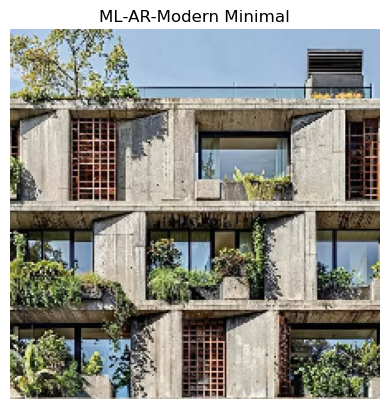

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 56.51%
ML-AR-COLONIAL : 19.53%
ML-AR-Oriental : 13.40%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


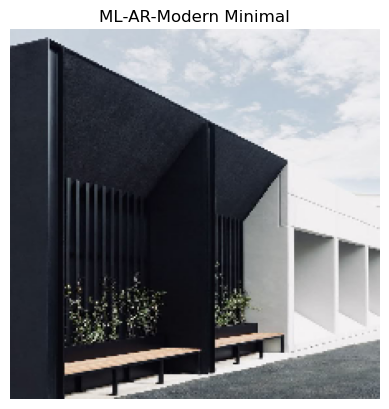

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 97.90%
ML-AR-SCANDINAVIAN : 1.68%
ML-AR-Modern : 0.22%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


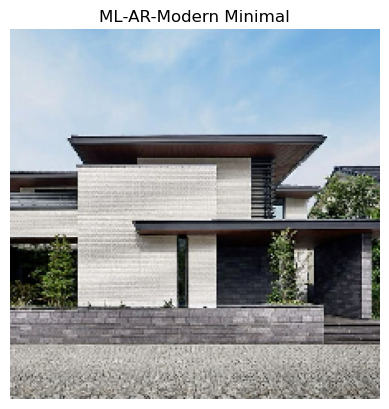

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 51.47%
ML-AR-SCANDINAVIAN : 36.03%
ML-AR-TRANSITIONAL : 5.20%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


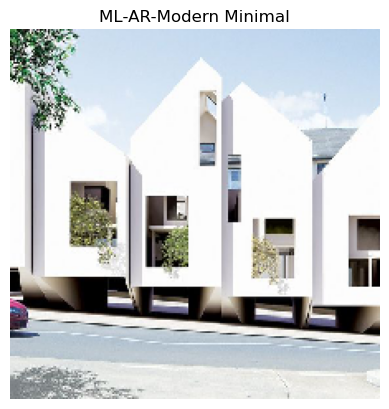

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 99.35%
ML-AR-TRANSITIONAL : 0.32%
ML-AR-SCANDINAVIAN : 0.29%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


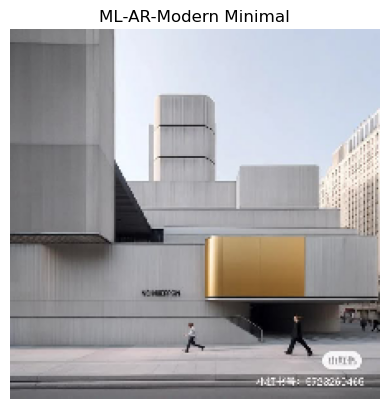

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 98.87%
ML-AR-Modern : 0.74%
ML-AR-SCANDINAVIAN : 0.36%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


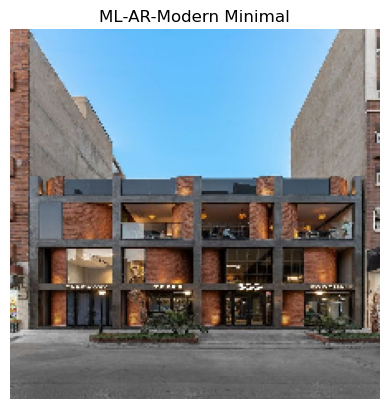

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 90.53%
ML-AR-TRANSITIONAL : 4.70%
ML-AR-SCANDINAVIAN : 2.49%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


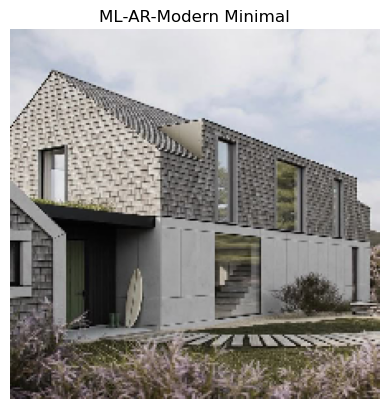

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 45.99%
ML-AR-SCANDINAVIAN : 31.09%
ML-AR-TRANSITIONAL : 16.23%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


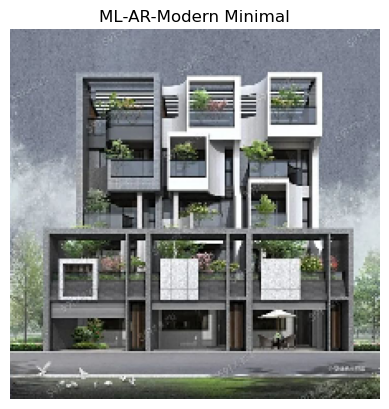

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 96.60%
ML-AR-Modern : 1.05%
ML-AR-Oriental : 0.80%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


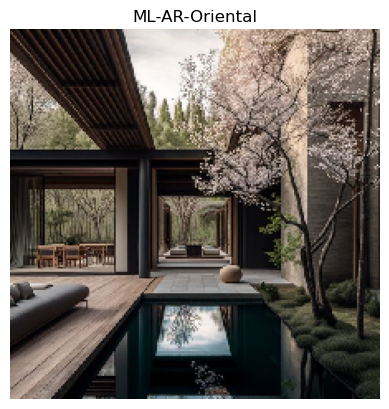

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 88.33%
ML-AR-Modern Minimal : 3.89%
ML-AR-Modern : 3.66%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-MID CENTURY


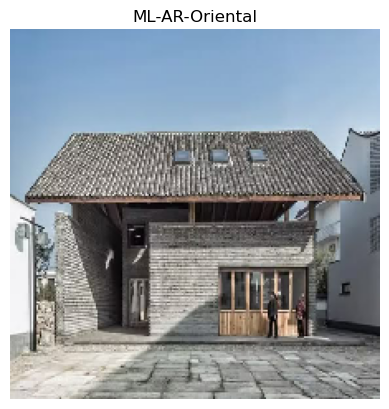

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 57.91%
ML-AR-Oriental : 24.27%
ML-AR-THAI : 8.39%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-SCANDINAVIAN


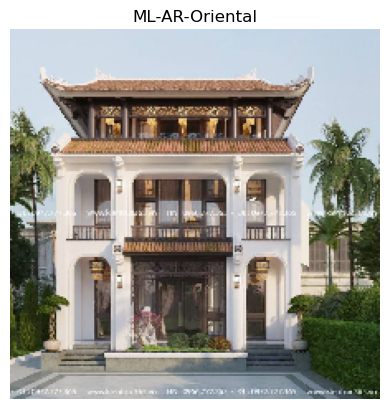

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 50.06%
ML-AR-COLONIAL : 34.13%
ML-AR-Classic : 7.03%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-VICTORIAN


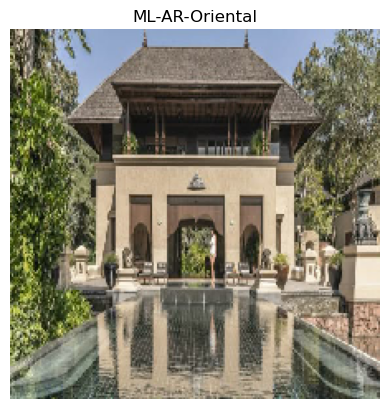

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Top 3 Predictions:
ML-AR-Classic : 52.20%
ML-AR-Oriental : 30.66%
ML-AR-Modern Minimal : 4.43%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Classic


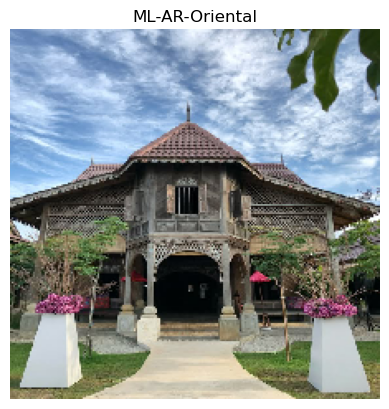

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 65.38%
ML-AR-THAI : 29.99%
ML-AR-Oriental : 2.50%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-TUDOR HOUSE


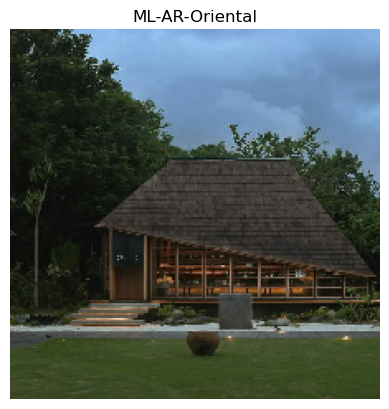

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 60.61%
ML-AR-Oriental : 29.69%
ML-AR-THAI : 2.37%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-SCANDINAVIAN


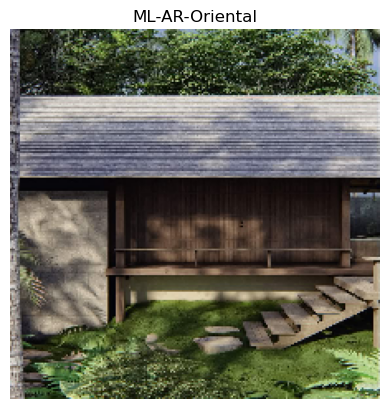

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
Top 3 Predictions:
ML-AR-Oriental : 39.66%
ML-AR-MID CENTURY : 31.26%
ML-AR-SCANDINAVIAN : 12.26%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Oriental


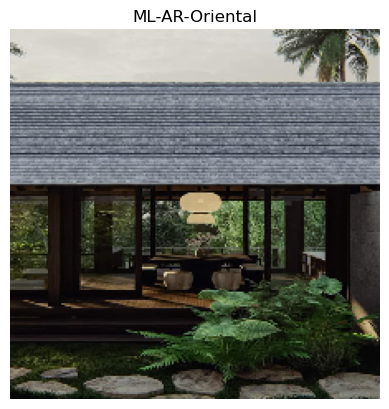

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Top 3 Predictions:
ML-AR-Oriental : 78.88%
ML-AR-SCANDINAVIAN : 13.20%
ML-AR-Modern Minimal : 3.81%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Oriental


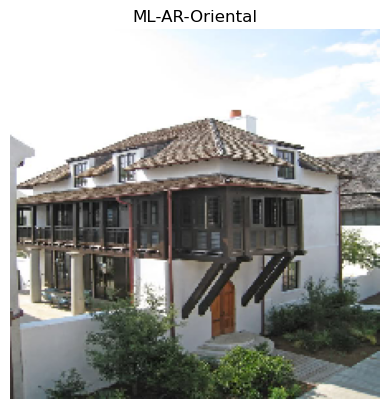

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Top 3 Predictions:
ML-AR-Modern : 20.79%
ML-AR-COLONIAL : 20.13%
ML-AR-THAI : 19.69%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Modern


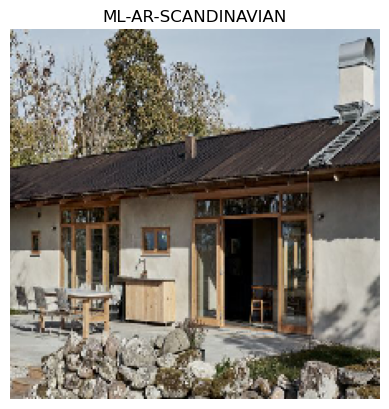

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 82.42%
ML-AR-Oriental : 10.61%
ML-AR-THAI : 2.81%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


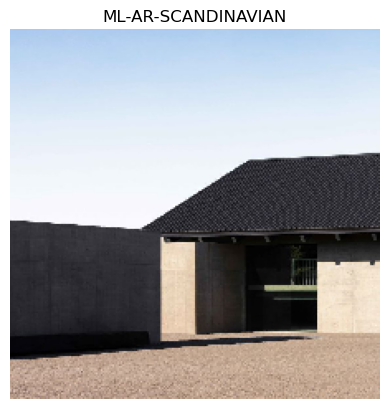

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 95.77%
ML-AR-Modern Minimal : 2.61%
ML-AR-Modern : 0.97%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


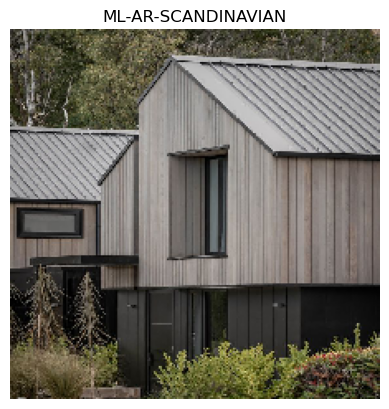

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 93.83%
ML-AR-Modern Minimal : 4.35%
ML-AR-Oriental : 0.92%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


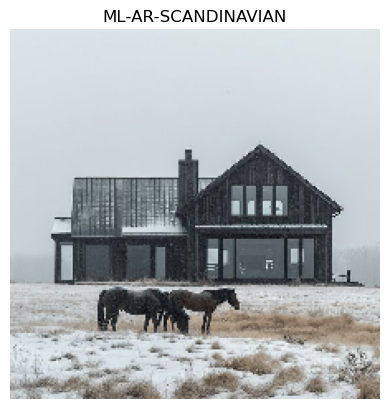

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 99.81%
ML-AR-THAI : 0.11%
ML-AR-Oriental : 0.04%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


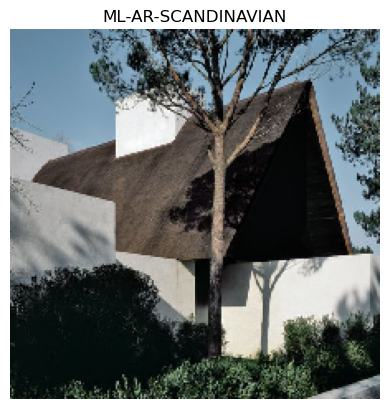

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 92.62%
ML-AR-Modern : 2.12%
ML-AR-Oriental : 1.90%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


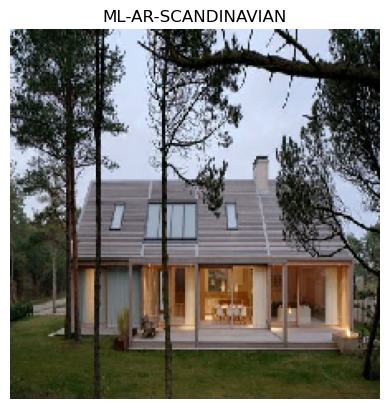

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 56.73%
ML-AR-SCANDINAVIAN : 27.01%
ML-AR-Modern Minimal : 5.70%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-TRANSITIONAL


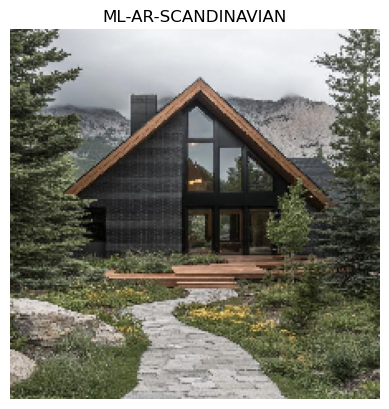

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 96.86%
ML-AR-TRANSITIONAL : 2.31%
ML-AR-THAI : 0.54%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-TUDOR HOUSE


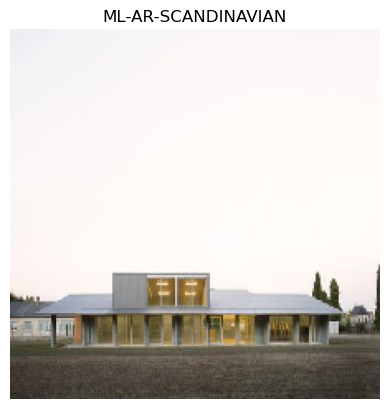

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 53.69%
ML-AR-SCANDINAVIAN : 23.23%
ML-AR-TRANSITIONAL : 8.76%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-Modern Minimal


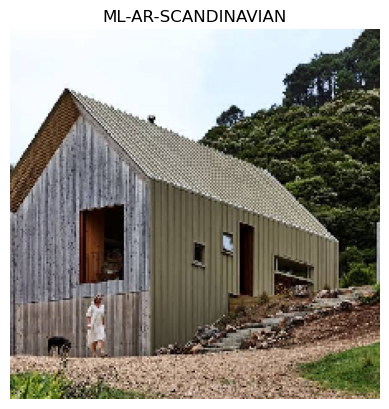

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 98.99%
ML-AR-Oriental : 0.54%
ML-AR-THAI : 0.23%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


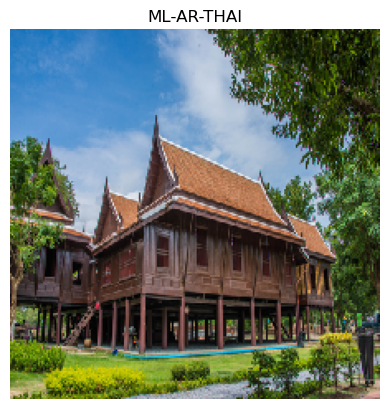

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
Top 3 Predictions:
ML-AR-THAI : 96.85%
ML-AR-Oriental : 2.08%
ML-AR-TUDOR HOUSE : 0.66%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


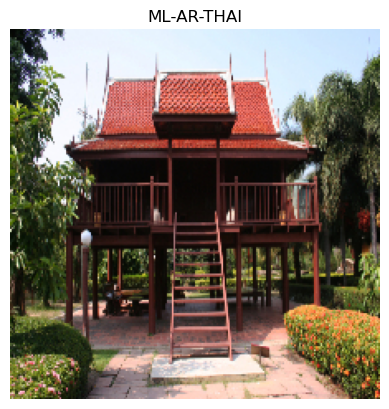

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
Top 3 Predictions:
ML-AR-THAI : 97.14%
ML-AR-Oriental : 1.79%
ML-AR-COLONIAL : 0.60%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


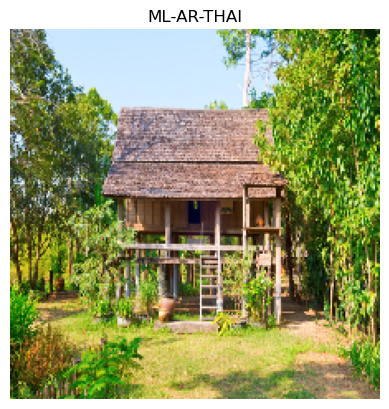

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
Top 3 Predictions:
ML-AR-THAI : 97.45%
ML-AR-Oriental : 1.46%
ML-AR-TUDOR HOUSE : 0.62%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


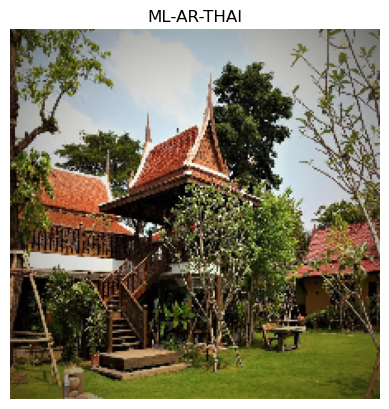

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
Top 3 Predictions:
ML-AR-THAI : 99.59%
ML-AR-Oriental : 0.29%
ML-AR-COLONIAL : 0.09%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


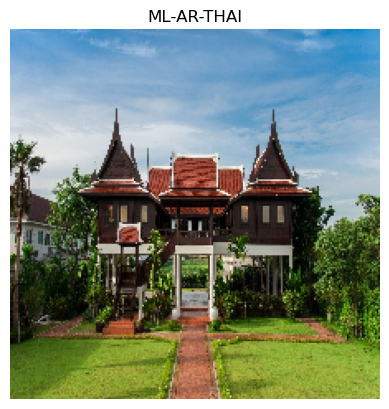

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Top 3 Predictions:
ML-AR-THAI : 90.47%
ML-AR-COLONIAL : 3.41%
ML-AR-Oriental : 2.27%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


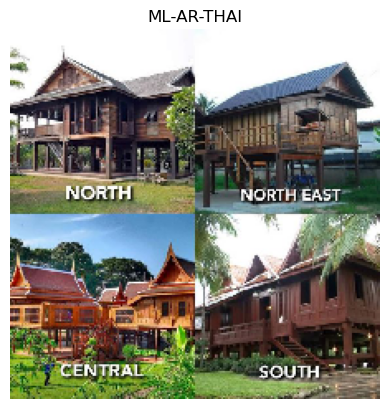

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Top 3 Predictions:
ML-AR-THAI : 73.59%
ML-AR-Oriental : 15.58%
ML-AR-TUDOR HOUSE : 9.65%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


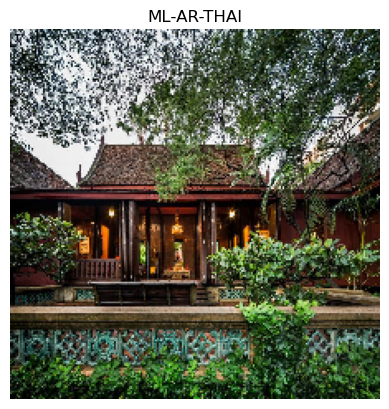

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Top 3 Predictions:
ML-AR-Oriental : 57.72%
ML-AR-MID CENTURY : 32.24%
ML-AR-THAI : 5.44%
Actual Class: ML-AR-THAI
Prediction: ML-AR-Oriental


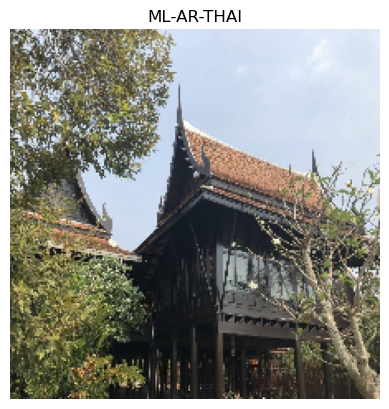

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Top 3 Predictions:
ML-AR-THAI : 93.41%
ML-AR-Oriental : 4.88%
ML-AR-TUDOR HOUSE : 0.98%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


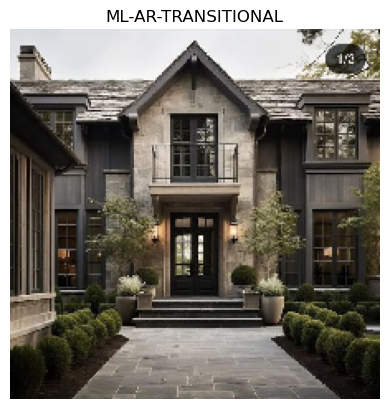

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 76.26%
ML-AR-TRANSITIONAL : 10.16%
ML-AR-Classic : 8.27%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TUDOR HOUSE


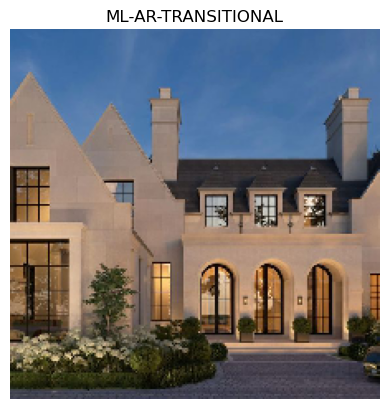

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 50.52%
ML-AR-TRANSITIONAL : 27.28%
ML-AR-Classic : 6.93%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-Modern Minimal


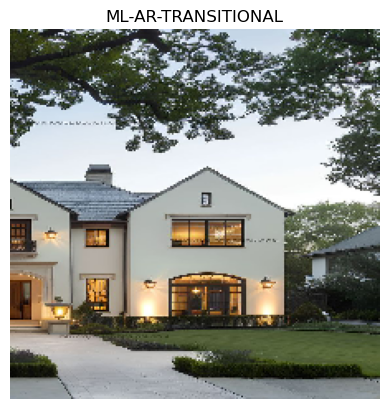

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 96.52%
ML-AR-TUDOR HOUSE : 2.19%
ML-AR-Modern Minimal : 0.71%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


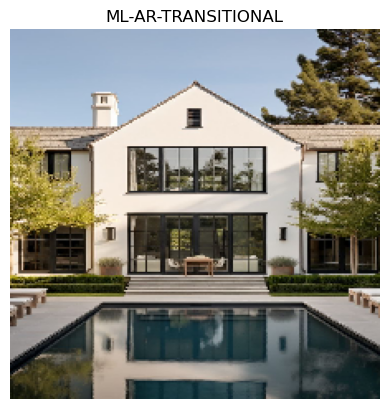

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 64.00%
ML-AR-SCANDINAVIAN : 12.10%
ML-AR-TRANSITIONAL : 10.92%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-Modern Minimal


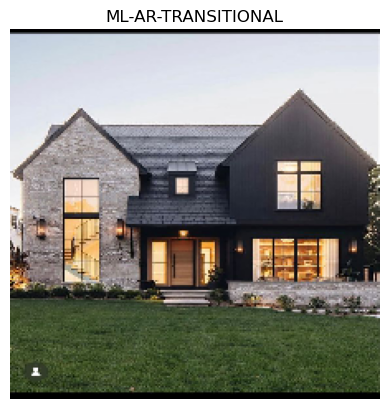

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 86.36%
ML-AR-SCANDINAVIAN : 8.93%
ML-AR-TUDOR HOUSE : 3.75%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


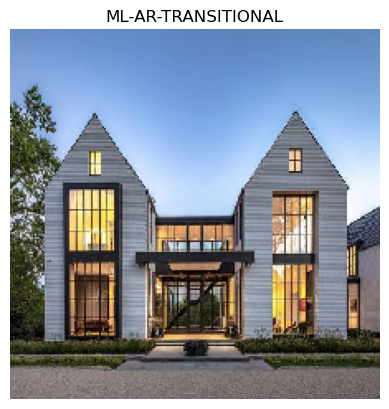

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 67.89%
ML-AR-TUDOR HOUSE : 27.61%
ML-AR-Modern Minimal : 1.43%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


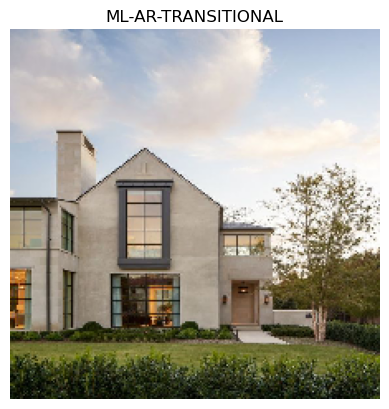

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 84.59%
ML-AR-TUDOR HOUSE : 11.65%
ML-AR-Modern Minimal : 1.45%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


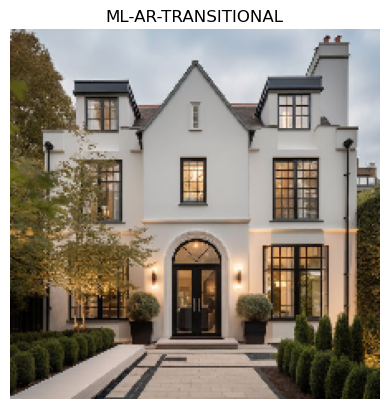

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 74.03%
ML-AR-TUDOR HOUSE : 23.69%
ML-AR-Classic : 1.03%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


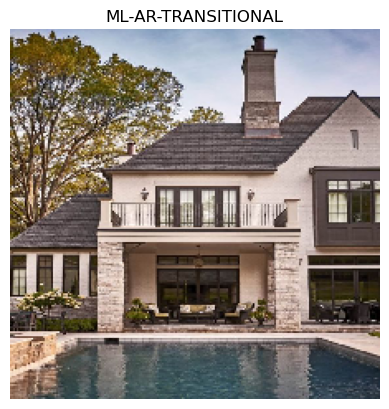

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-Classic : 32.69%
ML-AR-Oriental : 25.45%
ML-AR-TRANSITIONAL : 15.16%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-Classic


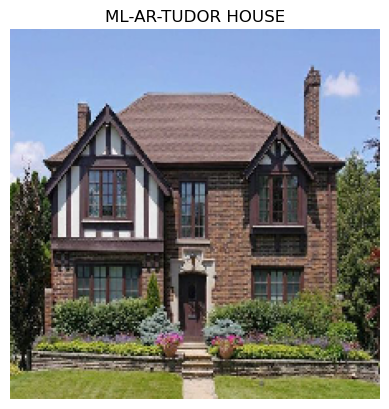

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 95.19%
ML-AR-THAI : 2.16%
ML-AR-TRANSITIONAL : 1.81%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


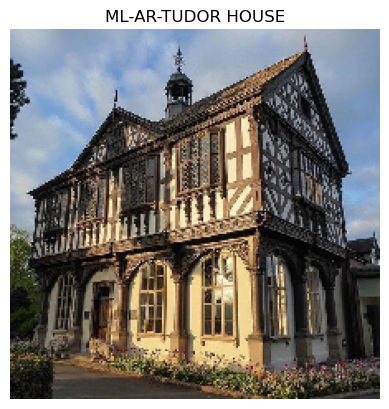

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 93.76%
ML-AR-VICTORIAN : 4.52%
ML-AR-MEDITERRANEAN : 0.52%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


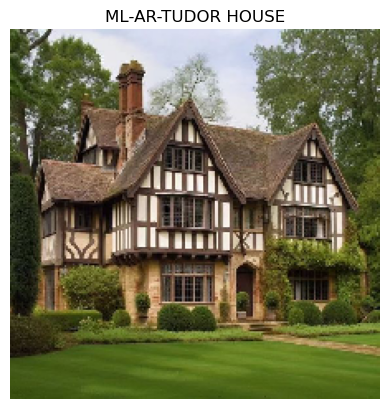

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 99.85%
ML-AR-TRANSITIONAL : 0.08%
ML-AR-THAI : 0.07%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


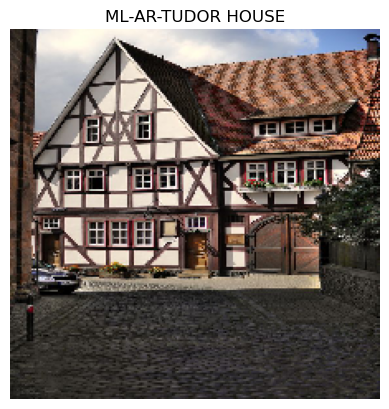

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 95.17%
ML-AR-THAI : 2.95%
ML-AR-TRANSITIONAL : 0.51%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


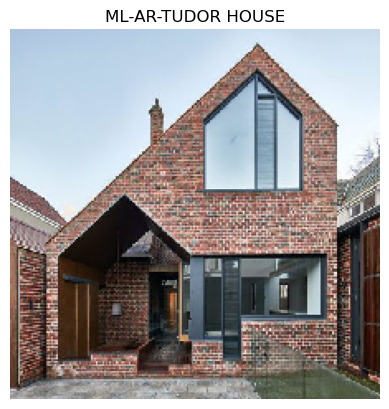

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 19.09%
ML-AR-TRANSITIONAL : 17.31%
ML-AR-Classic : 16.02%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-SCANDINAVIAN


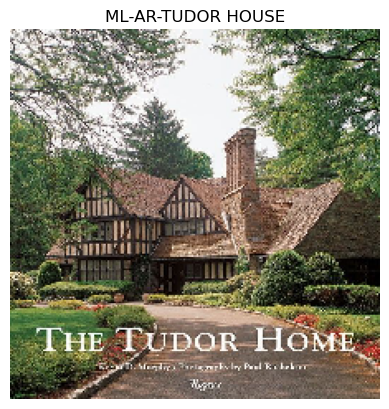

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 97.10%
ML-AR-THAI : 2.46%
ML-AR-Oriental : 0.11%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


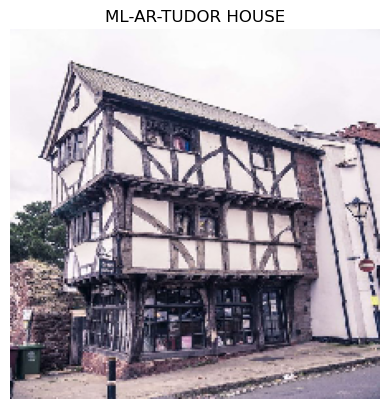

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 39.75%
ML-AR-VICTORIAN : 19.48%
ML-AR-THAI : 9.54%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


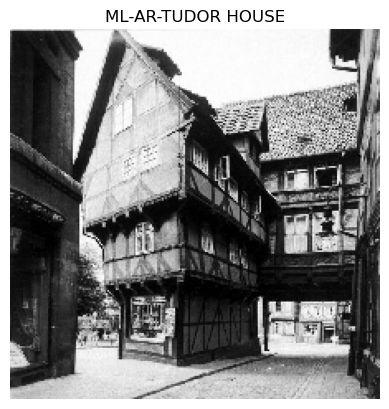

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 60.04%
ML-AR-TUDOR HOUSE : 15.85%
ML-AR-Modern : 5.75%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-VICTORIAN


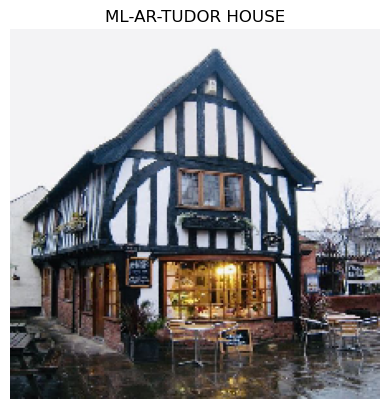

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 98.59%
ML-AR-THAI : 0.99%
ML-AR-TRANSITIONAL : 0.12%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


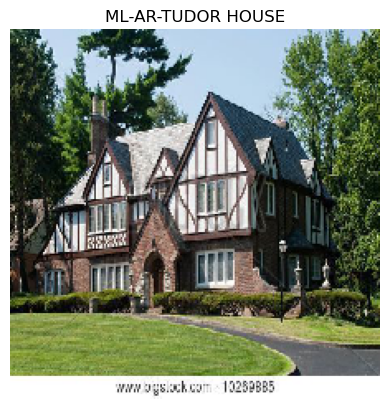

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 99.41%
ML-AR-TRANSITIONAL : 0.30%
ML-AR-THAI : 0.23%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


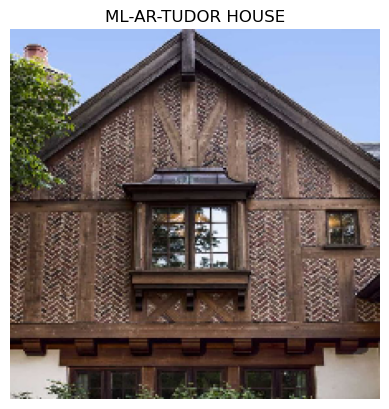

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
Top 3 Predictions:
ML-AR-THAI : 65.94%
ML-AR-TUDOR HOUSE : 13.41%
ML-AR-Oriental : 9.63%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-THAI


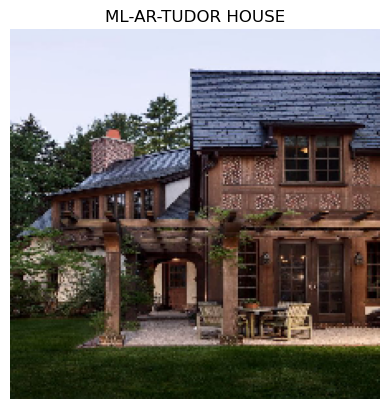

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
Top 3 Predictions:
ML-AR-Oriental : 46.29%
ML-AR-THAI : 16.62%
ML-AR-TUDOR HOUSE : 15.96%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-Oriental


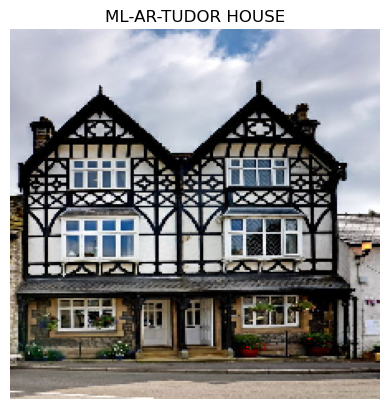

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 73.41%
ML-AR-VICTORIAN : 25.95%
ML-AR-COLONIAL : 0.32%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


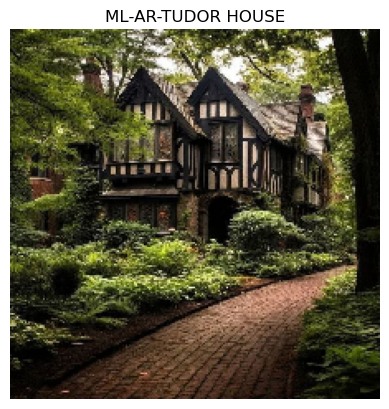

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 99.52%
ML-AR-THAI : 0.38%
ML-AR-TRANSITIONAL : 0.02%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


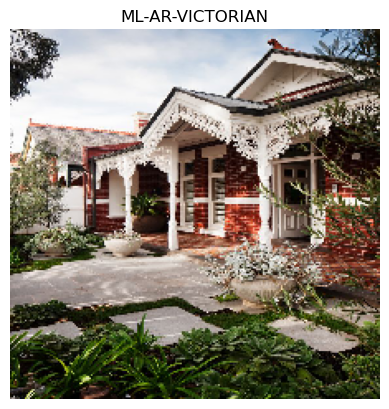

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-THAI : 79.93%
ML-AR-TUDOR HOUSE : 14.78%
ML-AR-Oriental : 2.04%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-THAI


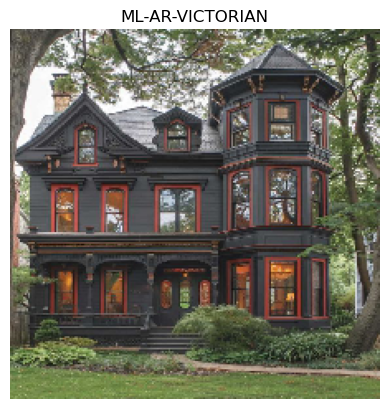

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
Top 3 Predictions:
ML-AR-Classic : 59.58%
ML-AR-TUDOR HOUSE : 19.04%
ML-AR-THAI : 6.82%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-Classic


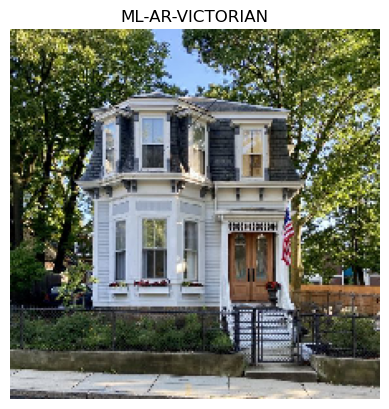

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 87.76%
ML-AR-COLONIAL : 4.02%
ML-AR-TUDOR HOUSE : 1.80%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


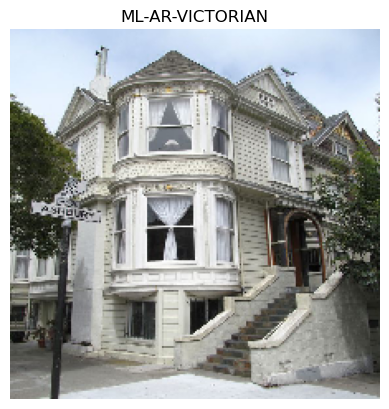

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 97.45%
ML-AR-Modern : 0.55%
ML-AR-TUDOR HOUSE : 0.52%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


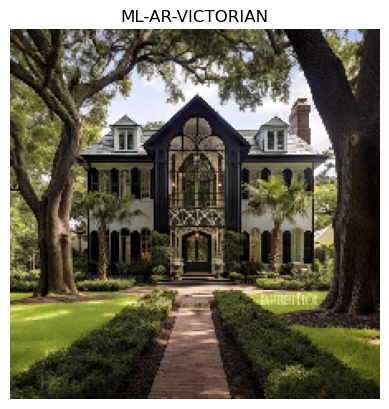

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 99.69%
ML-AR-Classic : 0.11%
ML-AR-MEDITERRANEAN : 0.05%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-TUDOR HOUSE


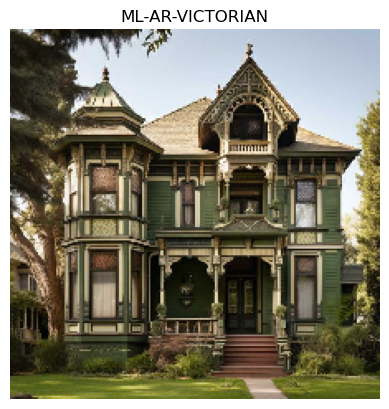

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 60.16%
ML-AR-TUDOR HOUSE : 23.60%
ML-AR-TRANSITIONAL : 5.27%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


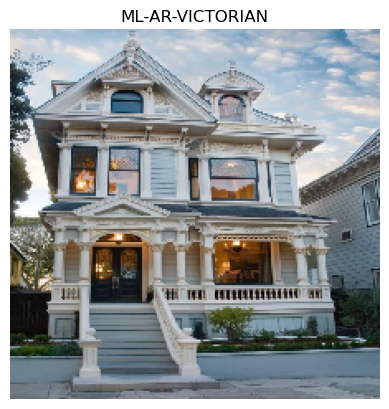

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 96.72%
ML-AR-COLONIAL : 1.73%
ML-AR-Classic : 1.08%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


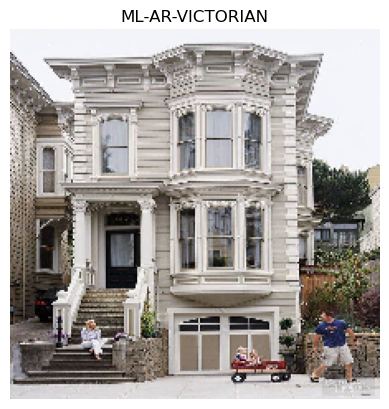

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 92.33%
ML-AR-COLONIAL : 3.17%
ML-AR-Classic : 1.99%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


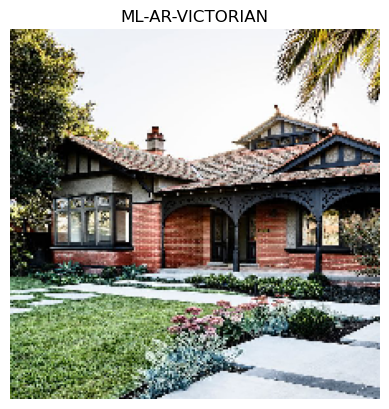

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 45.67%
ML-AR-THAI : 22.81%
ML-AR-MEDITERRANEAN : 15.73%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-TUDOR HOUSE


In [ ]:
import glob

import glob

# Get all images in the subfolders of "test"
mylist = [f for f in glob.glob(r'D:\Real Estate\_PLP-ML-AI\House_data\Train_Test_Folder\test\**\*', recursive=True) if not os.path.isdir(f)]

# # Print the list of image paths
# print(mylist)

for i in mylist:
    predict(i)
    # print(os.path.basename(i), end = '/')